## Mapping available GPS data

This notebook produces a map of where the available GPS data exists.

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import gzip
import pandas as pd
import numpy as np
import holoviews as hv
import geoviews as gv
import cartopy.crs as ccrs
import pyproj
import glob
from pathlib import Path
from tqdm import tqdm
from shapely import LineString
import pickle

from utig_radar_loading import file_util, stream_util, geo_util

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
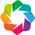

In [3]:
pd.options.mode.copy_on_write = True

hv.extension('bokeh')

### Single file

Test playground for messing with individual files. Feel free to skip this section.

In [4]:
# ct_path = "/kucresis/scratch/data/UTIG/UTIG1/targ/pcor/ASB/JKB2d/R17Wb/AQNnr1/xds.gz"
# file = gzip.open(ct_path, 'rt')
# print(file.readline())
# ct_columns = ['prj', 'set', 'trn', 'seq', 'clk_y', 'clk_n', 'clk_d', 'clk_h', 'clk_m', 'clk_s', 'clk_f', 'tim']
# pd.read_csv(file, sep=r'\s+', names=ct_columns, index_col=False)

In [5]:
# #gps_path = "/kucresis/scratch/data/UTIG/UTIG2/targ/pcor/AMY/JKB2u/X62c/GPSnc1/xds.gz"
# gps_path = "/kucresis/scratch/data/UTIG/UTIG1/targ/pcor/ALG/JKB0a/X01a/GPStp2/xds.gz"

# file = gzip.open(gps_path, 'rt')
# pd.read_csv(file, sep=r',', index_col=False, on_bad_lines='warn')

In [6]:
# df = stream_util.load_gzipped_stream_file(gps_path, debug=True, parse=True, parse_kwargs={'use_ct': True})
# df

In [7]:
# df_sub = df[['prj', 'set', 'trn', 'clk_y', 'LAT', 'LON']][::100]

# path = gv.Path(df_sub,
#                 ['LON', 'LAT'],
#                 ['prj', 'set', 'trn', 'clk_y'],
#                 crs=ccrs.PlateCarree()
#               ).opts(
#                 projection=ccrs.SouthPolarStereo(),
#                 tools=['hover'],
#                 color='red',
#                 line_width=2
#               )

# stream_util.create_antarctica_basemap() * path

### BedMap Location Information
Load positioning information from BedMap as a reference for where we would expect data to be

In [8]:
bedmap_csv_files = glob.glob("bedmap_utig/**/*UTIG*.csv")

bedmap_paths_cache_file = "outputs/bedmap_paths_cache.pkl"

if os.path.exists(bedmap_paths_cache_file):
    with open(bedmap_paths_cache_file, "rb") as f:
        bedmap_path_dfs = pickle.load(f)
else:
    bedmap_path_dfs = []

    for bedmap_path in tqdm(bedmap_csv_files):
        # Load the bedmap data
        df = pd.read_csv(bedmap_path, comment='#')[['longitude (degree_east)', 'latitude (degree_north)']]
        df = df.rename(columns={
            'longitude (degree_east)': 'LON',
            'latitude (degree_north)': 'LAT'
        })

        x_simplified, y_simplified = geo_util.project_split_and_simplify(df['LON'].values, df['LAT'].values)

        # Extract filename for tooltip
        filename = Path(bedmap_path).stem
        
        # Create dataframe with coordinates and tooltip info
        path_df = pd.DataFrame({
            'x': x_simplified,
            'y': y_simplified,
            'bedmap_src': filename
        })

        bedmap_path_dfs.append(path_df)

    with open(bedmap_paths_cache_file, "wb") as f:
        pickle.dump(bedmap_path_dfs, f)
    print(f"Saved cache of simplified BedMap paths to {bedmap_paths_cache_file}")


In [9]:
bedmap_df_concat = pd.concat(bedmap_path_dfs, ignore_index=True)

bedmap_path = hv.Path(
                bedmap_df_concat,
                ['x', 'y'],
                ['bedmap_src'],
                label='BedMap (UTIG)'
                    ).opts(
                        tools=['hover'],
                        line_width=0.5,
                        line_dash='solid',
                        color='gray',
                        show_legend=True
                    )

In [10]:
p = stream_util.create_antarctica_basemap() * bedmap_path
p = p.opts(aspect='equal', frame_width=500, frame_height=500, tools=['hover'])
p.opts(title='UTIG flight paths reported in BedMap')

:Overlay
   .Ocean.I                                             :Feature   [Longitude,Latitude]
   .Coastline.I                                         :Feature   [Longitude,Latitude]
   .Path.BedMap_left_parenthesis_UTIG_right_parenthesis :Path   [x,y]   (bedmap_src)

### Multi-file

In [11]:
use_cache = True
cache_dir = "outputs/file_index.csv"
base_path = "/kucresis/scratch/data/UTIG"

df_files = file_util.load_file_index_df(base_path, cache_dir, read_cache=use_cache)
df_artifacts = file_util.create_artifacts_df(df_files)

Reading from cache file outputs/file_index.csv


/kucresis/scratch/tteisberg_sta/scripts/python/utig_radar_loading/src/utig_radar_loading/file_util.py:11: DtypeWarning: Columns (14,15,16,17) have mixed types. Specify dtype option on import or set low_memory=False.
  df_files = pd.read_csv(cache_path, index_col=0)


In [12]:
df_files.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
0,/,kucresis,scratch,data,UTIG,UTIG2,orig,xlob,AMY,JKB2u,X62c,RADnh5,xds.gz,NaN,NaN,NaN,NaN
1,/,kucresis,scratch,data,UTIG,UTIG2,orig,xlob,AMY,JKB2u,Y164b,RADnh5,xds.gz,NaN,NaN,NaN,NaN
2,/,kucresis,scratch,data,UTIG,UTIG2,orig,xlob,AMY,JKB2u,Y174b,RADnh5,xds.gz,NaN,NaN,NaN,NaN
3,/,kucresis,scratch,data,UTIG,UTIG2,orig,xlob,AMY,JKB2u,Y210b,RADnh5,xds.gz,NaN,NaN,NaN,NaN
4,/,kucresis,scratch,data,UTIG,UTIG2,orig,xlob,AMY,JKB2u,Y226b,RADnh5,xds.gz,NaN,NaN,NaN,NaN


In [13]:
radar_stream_types = [s for s in df_artifacts['stream'].unique() if "RAD" in s]

df_artifacts_gps = df_artifacts[df_artifacts['stream'].isin(['GPSnc1', 'GPStp2', 'GPSap1', 'GPSap3'])]
df_artifacts_gps = df_artifacts_gps[df_artifacts_gps['file_name'] == 'xds.gz']

df_artifacts_rad = df_artifacts[df_artifacts['stream'].isin(radar_stream_types)]

df_artifacts_gps['radar_path'] = None
df_artifacts_gps['radar_stream_type'] = None

for row_idx in df_artifacts_gps.index:
    # Find rows in df_artifacts_rad matching prj, set, and trn
    matching_rows = df_artifacts_rad[
        (df_artifacts_rad['prj'] == df_artifacts_gps.loc[row_idx, 'prj']) &
        (df_artifacts_rad['set'] == df_artifacts_gps.loc[row_idx, 'set']) &
        (df_artifacts_rad['trn'] == df_artifacts_gps.loc[row_idx, 'trn'])
    ]

    if (len(matching_rows) > 0) and (len(matching_rows['stream'].unique()) == 1):
        rad_artifact = df_artifacts_rad.iloc[0]
        df_artifacts_gps.loc[row_idx, 'radar_path'] = rad_artifact['full_path']
        df_artifacts_gps.loc[row_idx, 'radar_stream_type'] = rad_artifact['stream']
    elif len(matching_rows) > 1:
        print(f"Warning: Multiple matching radar rows found for GPS row {row_idx} with different stream types")
        print(matching_rows)

In [14]:
#all_files_utig1 = list(df_artifacts[(df_artifacts['dataset'] == 'UTIG1') & (df_artifacts['stream'].isin(['GPSnc1', 'GPStp2', 'GPSap1']))]['full_path'])
#all_files_utig2 = list(df_artifacts[(df_artifacts['dataset'] == 'UTIG2') & (df_artifacts['stream'].isin(['GPSnc1', 'GPStp2', 'GPSap1']))]['full_path'])

df_artifacts_gps_utig1 = df_artifacts_gps[df_artifacts_gps['dataset'] == 'UTIG1']
df_artifacts_gps_utig2 = df_artifacts_gps[df_artifacts_gps['dataset'] == 'UTIG2']

In [15]:
def load_gps_data(artifacts_df):
    segment_dfs = []
    file_paths_success = []
    file_paths_success_line_km = []
    file_paths_success_line_km_shapely = []
    file_paths_fail = []

    for _, row in tqdm(artifacts_df.iterrows(), total=len(artifacts_df)):

        f = row['full_path']
        if 'GPSkc1' in f:
            file_paths_fail.append(f)
            continue # GPSkc1 does not contain position information
        if 'GPSnc2' in f:
            file_paths_fail.append(f)
            continue # GPSnc2 does not contain position information
        if 'GPSgp1' in f:
            file_paths_fail.append(f)
            # It appears that all segments with a GPSgp1 file already have either a GPSnc1 or GPStp2 file that we can parse
            continue # No stream format information available for GPSgp1

        try:
            df = stream_util.load_gzipped_stream_file(f, debug=False, parse=True, parse_kwargs={'use_ct': True})

            line_length_km = stream_util.calculate_track_distance_km(df)

            _, _, line_length_m_shapely = geo_util.project_split_and_simplify(df['LON'].values, df['LAT'].values, calc_length=True)

            necessary_keys = ['prj', 'set', 'trn', 'clk_y', 'LAT', 'LON', 'TIMESTAMP']
            for k in necessary_keys:
                if k not in df:
                    df[k] = np.nan

            df_sub = df[['prj', 'set', 'trn', 'clk_y', 'LAT', 'LON', 'TIMESTAMP']]

            # Add radar stream type
            df_sub['radar_stream_type'] = row['radar_stream_type']

            segment_dfs.append(df_sub)

            file_paths_success.append(f)
            file_paths_success_line_km.append(line_length_km)
            file_paths_success_line_km_shapely.append(line_length_m_shapely / 1000)
        except Exception as e:
            file_paths_fail.append(f)
            print(f"Error loading {f}: {e}")

    print(f"Successfully loaded {len(file_paths_success)} files.")
    print(f"Failed to load {len(file_paths_fail)} files.")
    print(f"Skipped loading {len(artifacts_df) - len(file_paths_success) - len(file_paths_fail)} files.")

    return {
        'segment_dfs': segment_dfs,
        'file_paths_success': file_paths_success,
        'file_paths_success_line_km': file_paths_success_line_km,
        'file_paths_success_line_km_shapely': file_paths_success_line_km_shapely,
        'file_paths_fail': file_paths_fail
    }

print("== UTIG1 ==")
data_utig1 = load_gps_data(df_artifacts_gps_utig1)
print("== UTIG2 ==")
data_utig2 = load_gps_data(df_artifacts_gps_utig2)

== UTIG1 ==


  4%|▍         | 117/2691 [00:41<28:05,  1.53it/s]

 21%|██        | 562/2691 [03:37<10:56,  3.24it/s]

 22%|██▏       | 592/2691 [03:47<10:08,  3.45it/s]

 26%|██▌       | 700/2691 [04:29<17:36,  1.89it/s]

 94%|█████████▍| 2525/2691 [09:17<01:29,  1.85it/s]/kucresis/scratch/tteisberg_sta/scripts/python/utig_radar_loading/.venv/lib/python3.13/site-packages/numpy/lib/_function_base_impl.py:1518: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/kucresis/scratch/tteisberg_sta/scripts/python/utig_radar_loading/.venv/lib/python3.13/site-packages/shapely/measurement.py:196: RuntimeWarning: invalid value encountered in length
  return lib.length(geometry, **kwargs)
 94%|█████████▍| 2526/2691 [09:18<01:29,  1.85it/s]

Error loading /kucresis/scratch/data/UTIG/UTIG1/targ/pcor/WSB/JKB0a/R16a/GPStp2/xds.gz: IllegalArgumentException: Non-finite envelope bounds passed to index insert


 94%|█████████▍| 2529/2691 [09:20<01:39,  1.63it/s]/kucresis/scratch/tteisberg_sta/scripts/python/utig_radar_loading/.venv/lib/python3.13/site-packages/numpy/lib/_function_base_impl.py:1518: RuntimeWarning: invalid value encountered in subtract
  a = op(a[slice1], a[slice2])
/kucresis/scratch/tteisberg_sta/scripts/python/utig_radar_loading/.venv/lib/python3.13/site-packages/shapely/measurement.py:196: RuntimeWarning: invalid value encountered in length
  return lib.length(geometry, **kwargs)
 94%|█████████▍| 2530/2691 [09:20<01:35,  1.68it/s]

Error loading /kucresis/scratch/data/UTIG/UTIG1/targ/pcor/WSB/JKB0a/R23a/GPStp2/xds.gz: IllegalArgumentException: Non-finite envelope bounds passed to index insert


100%|██████████| 2691/2691 [10:13<00:00,  4.38it/s]


Successfully loaded 2689 files.
Failed to load 2 files.
Skipped loading 0 files.
== UTIG2 ==


100%|██████████| 189/189 [00:26<00:00,  7.17it/s]


Successfully loaded 189 files.
Failed to load 0 files.
Skipped loading 0 files.


Text(0, 0.5, 'Counts')

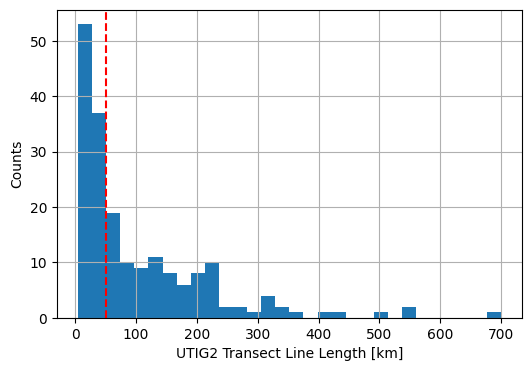

In [16]:
import matplotlib.pyplot as plt
fig, ax = plt.subplots(1, 1, figsize=(6, 4))
ax.hist(data_utig2["file_paths_success_line_km"], bins=30)
ax.grid()
# Add a vertical line at 50 km
ax.axvline(50, color='r', linestyle='--')
ax.set_xlabel('UTIG2 Transect Line Length [km]')
ax.set_ylabel('Counts')

In [17]:
# import matplotlib.pyplot as plt
# fig, axs = plt.subplots(1, 3, figsize=(10, 4))
# axs[0].hist(data_utig2["file_paths_success_line_km"], bins=20)
# axs[1].hist(data_utig2["file_paths_success_line_km_shapely"], bins=20)
# axs[2].hist(np.array(data_utig2["file_paths_success_line_km"]) - np.array(data_utig2["file_paths_success_line_km_shapely"]), bins=20)

In [18]:
print("== UTIG1 ==")
if len(data_utig1['segment_dfs']) > 0:
    dfs_utig1, path_utig1 = geo_util.create_path(data_utig1['segment_dfs'], path_opts_kwargs={'color': 'orange'})
else:
    dfs_utig1, path_utig1 = [], None
print(f"Generated {len(dfs_utig1)} flights from {len(data_utig1['segment_dfs'])} segments.")

print("== UTIG2 ==")
if len(data_utig2['segment_dfs']) > 0:
    dfs_utig2, path_utig2 = geo_util.create_path(data_utig2['segment_dfs'], path_opts_kwargs={'color': 'purple'})
else:
    dfs_utig2, path_utig2 = [], None
print(f"Generated {len(dfs_utig2)} flights from {len(data_utig2['segment_dfs'])} segments.")

== UTIG1 ==
segment_dfs[1123]['clk_y'].unique(): [1904 2014]
Generated 2677 flights from 2689 segments.
== UTIG2 ==
Generated 189 flights from 189 segments.


In [19]:
data_utig1

{'segment_dfs': [      prj    set   trn  clk_y        LAT        LON           TIMESTAMP  \
  0     AHL  JKB2n  R50a   2016 -69.410418  78.574973 2016-01-11 08:18:32   
  1     AHL  JKB2n  R50a   2016 -69.411180  78.575555 2016-01-11 08:18:33   
  2     AHL  JKB2n  R50a   2016 -69.411943  78.576136 2016-01-11 08:18:34   
  3     AHL  JKB2n  R50a   2016 -69.412707  78.576716 2016-01-11 08:18:35   
  4     AHL  JKB2n  R50a   2016 -69.413473  78.577296 2016-01-11 08:18:36   
  ...   ...    ...   ...    ...        ...        ...                 ...   
  4088  AHL  JKB2n  R50a   2016 -72.459285  81.276915 2016-01-11 09:26:40   
  4089  AHL  JKB2n  R50a   2016 -72.460025  81.277768 2016-01-11 09:26:41   
  4090  AHL  JKB2n  R50a   2016 -72.460765  81.278622 2016-01-11 09:26:42   
  4091  AHL  JKB2n  R50a   2016 -72.461506  81.279471 2016-01-11 09:26:43   
  4092  AHL  JKB2n  R50a   2016 -72.462246  81.280312 2016-01-11 09:26:44   
  
       radar_stream_type  
  0               RADnh5  
  1 

In [20]:
# Plot
p = stream_util.create_antarctica_basemap() * bedmap_path
if path_utig1:
    p *= path_utig1.relabel('UTIG1')
if path_utig2:
    p *= path_utig2.relabel('UTIG2')
p = p.opts(legend_position='right', show_legend=True, click_policy='hide')
p = p.opts(aspect='equal')
p.opts(frame_width=500, frame_height=500)

:Overlay
   .Ocean.I                                             :Feature   [Longitude,Latitude]
   .Coastline.I                                         :Feature   [Longitude,Latitude]
   .Path.BedMap_left_parenthesis_UTIG_right_parenthesis :Path   [x,y]   (bedmap_src)
   .Path.UTIG1                                          :Path   [x,y]   (prj,set,trn,clk_y,radar)
   .Path.UTIG2                                          :Path   [x,y]   (prj,set,trn,clk_y,radar)

In [21]:
# hv.save(p.opts(
#                 title='UTIG1 (orange) and UTIG2 (purple) GPS Tracks',
#                 frame_height=800, frame_width=800
#             ),
#             'outputs/utig_gps.html')

In [22]:
line_km = np.array(data_utig1['file_paths_success_line_km'])
line_km = line_km[~np.isnan(line_km)]
print(f"UTIG1: {line_km.sum().item():.1f} line km")

line_km = np.array(data_utig2['file_paths_success_line_km'])
line_km = line_km[~np.isnan(line_km)]
print(f"UTIG2: {line_km.sum().item():.1f} line km")

UTIG1: 3889883970382754287190016.0 line km
UTIG2: 19692.6 line km


### Scratch

In [23]:
# file_paths_fail = data_utig2['file_paths_fail']
# file_paths_success = data_utig2['file_paths_success']
# file_paths_success_line_km = data_utig2['file_paths_success_line_km']

# # Files that failed to load
# failed_files = pd.DataFrame(
#       [Path(fp).parts[-5:-1] for fp in file_paths_fail],
#       columns=['campaign', 'flight', 'segment', 'stream_type']
#   )
# failed_files['path'] = file_paths_fail
# failed_files['success'] = 0
# failed_files['line_km'] = 0

# # Successfully loaded files
# successful_files = pd.DataFrame(
#       [Path(fp).parts[-5:-1] for fp in file_paths_success],
#       columns=['campaign', 'flight', 'segment', 'stream_type']
#   )
# successful_files['path'] = file_paths_success
# successful_files['success'] = 1
# successful_files['line_km'] = file_paths_success_line_km

# merged_files = pd.concat([successful_files, failed_files], ignore_index=True)

# # Group by ['campaign', 'flight', 'segment'] and then sum success
# grouped = merged_files.groupby(['campaign', 'flight', 'segment']).sum().reset_index()

# print(f"Found a total of {grouped['line_km'].sum()} km")

# print(f"The following flights may not have loaded successfully:")
# grouped[grouped['success'] != 1]

In [24]:
#grouped

In [25]:
#successful_files